## Objective of the Notebook:

### Main Objective : Given a fluroscopic image - Locate the Guide wire Region - Crop out the region - Predict angle and centre offset - Compare results with Ground Truth for Train and validation


#### Milestones:

1. Load the test data images and preprocess
2. Run FasterRCNN model and get results - crop each resultant predicted image and use it as input for Resnet50 predict angle and pos model
3. For each bounding box - get the angle and pos - Compare with GT - Report Results

In [1]:
# Imports
import pathlib
import numpy as np
from matplotlib import pyplot as plt
from skimage import exposure
from sklearn.model_selection import train_test_split
import torch
import torchvision  # modules and transforms for computer vision
from tqdm.auto import tqdm  # progress bar
import torchvision.models as models
from sklearn.metrics import mean_absolute_error
from torchvision.models.detection import faster_rcnn
import statistics

In [2]:
# Mounting drive - to be used as switch later - local system or drive
colab=False
if colab:
  import google
  google.colab.drive.mount('/content/drive', force_remount=True)
  drive = pathlib.Path('./drive/MyDrive/')

else:
  drive="D:\\Project\\Data\\"

In [3]:
# Want to Run Train 0 or Validation 1
choice=0

### Milestone 1 - Load Test Data and Preprocess

In [4]:
fdataset = pathlib.Path(drive +'GuidewireDataset.npz')
with np.load(fdataset) as f:
    dataset = dict(f)

In [5]:
# Looping through each image, position and direction - from the dictionary
images = [x.astype(float) for x in dataset['images']] # Making images in floating point dtype
images = [exposure.equalize_hist(x) for x in images] # Performing histogram equalization
images = [np.interp(x, (0,1), (np.min(x),np.max(x))) for x in images] # Making the range from 0 to 1 
images = [1 - x for x in images] # Making the guidewire(target) - to have the higher side of contrast - to boost the network 
positions = [np.transpose(x) for x in dataset['positions']] # Extracting the position - transposing to get x | y in columns than in rows - to plot easily 
directions = [np.transpose(x) for x in dataset['directions']]# Extracting the direction  transposing to get x | y in columns than in rows - to plot easily 

In [6]:
# Generating the dataset - in form of images and target bounding boxes
Generated_images=[]
Targets=[]

number_of_images=len(images)
for id in range(number_of_images):
    i = id  # image index
    w = 50  # window size - half (since left and right)
    target={}
    boxes=[]
    angles=[]
    centers=[]
    for position, direction in zip(positions[i].T, directions[i].T):
      j1, j2 = round(position[1] - w), round(position[1] + w + 1)
      k1, k2 = round(position[0] - w), round(position[0] + w + 1)
      generated_image=images[i]
      angle = np.rad2deg(np.arctan2(*direction))
      if angle < 0:
          angle = 360 + angle
      centre=(position[0],position[1])
      boxes.append([k1, j1, k2, j2])
      angles.append(angle)
      centers.append(centre)
        
    areas = [(xmax - xmin) * (ymax - ymin) for xmin, ymin, xmax, ymax in boxes]
    target['boxes'] = np.array(boxes, dtype=np.float32)
    target['labels'] = np.ones(len(boxes), dtype=np.int64)
    target['image_id'] = np.array([id], dtype=np.int64)
    target['area'] = np.array(areas, dtype=np.float32)
    target['iscrowd'] = np.zeros(len(boxes), dtype=np.int64)
    target['Angle']=np.array(angles, dtype=np.float32)
    target['Centre']=np.array(centers, dtype=np.float32)
    Targets.append(target)
    Generated_images.append(images[i])

In [7]:
print(len(Generated_images))
print(len(Targets))

314
314


In [8]:
if choice==0:
    check_test=np.load(drive+"Train_Indices.npy")
else:
    check_test=np.load(drive+"Val_Indices.npy")

test_indices=check_test.tolist()

print(test_indices)

[220, 125, 255, 207, 299, 161, 208, 34, 232, 72, 293, 102, 280, 110, 178, 30, 166, 139, 40, 257, 106, 190, 53, 261, 18, 118, 35, 1, 136, 253, 172, 262, 243, 308, 33, 55, 246, 284, 218, 95, 48, 94, 68, 27, 87, 70, 156, 115, 120, 176, 247, 153, 13, 99, 179, 292, 291, 224, 169, 170, 138, 277, 219, 310, 268, 303, 63, 97, 289, 191, 41, 54, 158, 37, 24, 214, 200, 133, 0, 71, 155, 45, 167, 254, 89, 92, 162, 259, 9, 171, 174, 279, 51, 96, 225, 131, 251, 7, 290, 168, 313, 185, 271, 64, 2, 223, 146, 119, 103, 23, 28, 237, 244, 307, 113, 144, 212, 29, 148, 297, 265, 151, 56, 15, 283, 222, 197, 93, 6, 267, 258, 270, 101, 157, 165, 57, 21, 202, 17, 75, 192, 195, 273, 129, 108, 104, 149, 173, 281, 227, 85, 287, 182, 188, 193, 111, 32, 88, 294, 36, 286, 175, 127, 282, 235, 11, 91, 241, 256, 19, 206, 260, 3, 240, 147, 272, 150, 43, 205, 26, 217, 90, 78, 236, 216, 296, 81, 204, 112, 226, 130, 249, 152, 52, 124, 213, 86, 159, 181, 275, 301, 196, 228, 4, 295, 62, 274, 12, 50, 60, 44, 180, 305, 22, 49, 23

In [9]:
Test_Images=[Generated_images[x] for x in test_indices]
Test_Targets=[Targets[x] for x in test_indices]

In [10]:
print(len(Test_Targets))
print(Test_Targets[0])

230
{'boxes': array([[382., 423., 483., 524.],
       [349., 441., 450., 542.]], dtype=float32), 'labels': array([1, 1], dtype=int64), 'image_id': array([220], dtype=int64), 'area': array([10201., 10201.], dtype=float32), 'iscrowd': array([0, 0], dtype=int64), 'Angle': array([102.64302, 108.65305], dtype=float32), 'Centre': array([[432.30518, 473.25668],
       [399.09656, 490.65784]], dtype=float32)}


In [11]:
# Creating the Dataset in torch form
class Dataset_Guide_wire_Tip(torch.utils.data.Dataset):
    def __init__(self, list_of_images, list_of_targets, transform=None):
        super().__init__()
        self.images=list_of_images
        self.targets=list_of_targets
        self._transform=transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image = self.images[index]
        image=np.repeat(image[:, :, np.newaxis], 3, axis=2) # Putting same image three times for three channels
        image = image.transpose([2,0,1])
        image = image.astype(np.float32)
        target=self.targets[index]
        image = torch.as_tensor(image.copy())
        for key, value in target.items():
            if torch.is_tensor(value):
                value=value.numpy()
            target[key] = torch.as_tensor(value.copy())

        if self._transform is not None:
            image, target = self._transform([image, target])
        #print(target)
        return image, target

In [12]:
def collate(batch):
    return tuple(zip(*batch))

In [13]:
loader_test = torch.utils.data.DataLoader(
    dataset=Dataset_Guide_wire_Tip(Test_Images,Test_Targets),
    batch_size=1,
    collate_fn=collate)

### Milestone 2 - Run Faster RCNN model and resnet50 model - Get position and angle

In [14]:
class FastRCNNPredictor(torch.nn.Module):

    def __init__(self, in_features, num_classes):
        super().__init__()
        self.cls_score = torch.nn.Linear(in_features, num_classes)
        self.bbox_pred = torch.nn.Linear(in_features, num_classes * 4)

    def forward(self, x):
        x = x.flatten(start_dim=1)
        scores = self.cls_score(x)
        bbox_deltas = self.bbox_pred(x)
        return scores, bbox_deltas

In [15]:
model=torch.load(drive+"Faster_RCNN_mode.pth")
model2=torch.load(drive+"Predict_angle_centre_offset.pth")
device = torch.device('cuda')

In [16]:
score_threshold = 0.5

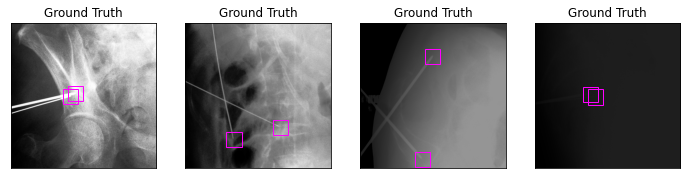

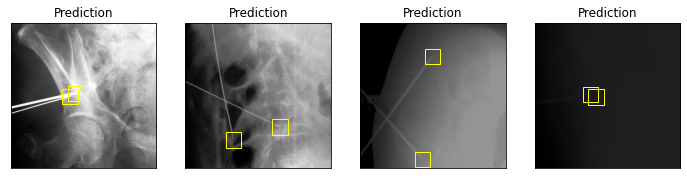

In [17]:
nimages = 4
fig, axs = plt.subplots(ncols=nimages, figsize=(nimages*3,3), subplot_kw={'xticks': [], 'yticks': [],'title':'Ground Truth'})
fig, axs2 = plt.subplots(ncols=nimages, figsize=(nimages*3,3), subplot_kw={'xticks': [], 'yticks': [],'title':'Prediction'})
i = 0
with torch.no_grad():
    model.eval()
    for images, targets in loader_test: 
        if i >= nimages:
            break
        predictions = model([x.to(device) for x in images])
        for image, target, prediction in zip(images, targets, predictions):
            if i >= nimages:
                break
            axs[i].imshow(image.numpy().transpose([1,2,0]))
            axs2[i].imshow(image.numpy().transpose([1,2,0]))
            for xmin, ymin, xmax, ymax in target['boxes'].numpy():
                axs[i].add_patch(plt.Rectangle((xmin, ymin), xmax - xmin + 1, ymax - ymin + 1, ec='magenta', fc='none'))
            for (xmin, ymin, xmax, ymax), score in zip(prediction['boxes'].cpu().numpy(), prediction['scores'].cpu().numpy()):
                if score < score_threshold:
                    continue
                axs2[i].add_patch(plt.Rectangle((xmin, ymin), xmax - xmin + 1, ymax - ymin + 1, ec='yellow', fc='none'))
            i += 1

In [18]:
def intersection_over_union(box_a, box_b):
    xmin = max(box_a[0], box_b[0])
    ymin = max(box_a[1], box_b[1])
    xmax = min(box_a[2], box_b[2])
    ymax = min(box_a[3], box_b[3])
    area_ab = max(0, xmax - xmin + 1) * max(0, ymax - ymin + 1)
    area_a = (box_a[2] - box_a[0] + 1) * (box_a[3] - box_a[1] + 1)
    area_b = (box_b[2] - box_b[0] + 1) * (box_b[3] - box_b[1] + 1)
    return 100 * area_ab / (area_a + area_b - area_ab)

In [19]:
def calculate_euclidean_distance(x1,y1,x2,y2):
    eus=((x2-x1)**2)+((y2-y1)**2)
    eud=eus**(0.5)
    return eud.item()

In [20]:
def predict_plot_and_return_erros(images,targets):
    predictions = model([x.to(device) for x in images])
    unique_boxes=[]
    ED_error=[]
    AE=[]
    fig1, ax1 = plt.subplots(figsize=(3,3))
    fig2, ax2 = plt.subplots(figsize=(3,3))
    fig3, ax3 = plt.subplots(figsize=(3,3))
    for image, target, prediction in zip(images, targets, predictions):
        for box_a,angle,cen in zip(target['boxes'].numpy(),target['Angle'].numpy(),target['Centre'].numpy()):
            iou=[]
            for box_b, score in zip(prediction['boxes'].cpu().numpy(), prediction['scores'].cpu().numpy()):
                if score < score_threshold:
                    continue
                iou.append(intersection_over_union(box_a, box_b))
            
            
            whichbox=np.argmax(iou)
            unique_boxes.append(whichbox)
            boxes=prediction['boxes'].cpu().numpy()
            box=boxes[whichbox]
            k1, j1, k2, j2=box
            if torch.is_tensor(image):
                image2=image.numpy()
                
            ax1.imshow(image2.transpose([1,2,0]),cmap='gray')
            ax1.add_patch(plt.Rectangle((k1, j1), k2 - k1 + 1, j2 - j1 + 1, ec='yellow', fc='none'))
            
            #Angle and pos prediction
            image2=image[0]
            if torch.is_tensor(image2):
                image2=image2.numpy()
            
            j_cen=(j1+j2)/2
            k_cen=(k1+k2)/2
            w=50
            j1, j2 = round(j_cen - w), round(j_cen + w + 1)
            k1, k2 = round(k_cen - w), round(k_cen + w + 1)
            image_for_angle_pred=image2[round(j1):round(j2),round(k1):round(k2)]
            
            #Applying the model
            model2.eval()
            image_for_angle_pred=np.expand_dims(image_for_angle_pred, axis=0)
            image_for_angle_pred=np.expand_dims(image_for_angle_pred, axis=0)
            image_for_angle_pred = image_for_angle_pred.astype(np.float32) 
            image_for_angle_pred = torch.as_tensor(image_for_angle_pred.copy())  # cast NumPy array to Torch tensor
            outputs = model2(image_for_angle_pred.to(device))
            sine_predictions = outputs[:,0].cpu()
            cosine_predictions = outputs[:,1].cpu()
            x_pos_predictions=outputs[:,2].cpu()
            y_pos_predictions=outputs[:,3].cpu()
            predicted_angle = np.rad2deg(np.arctan2(sine_predictions.item(),cosine_predictions.item()))
            if predicted_angle<0:
                predicted_angle+=360
                
                
            if whichbox==0:
                ax2.imshow(image_for_angle_pred[0].numpy().transpose([1,2,0]),cmap='gray')
                print("BOX 1")
                print("Predicted Angle is ",predicted_angle)
                print("Ground Truth angle is ",angle)
                X=x_pos_predictions+k_cen
                print("Predicted X is ",X)
                print("Ground Truth X pos is ",cen[0])
                Y=y_pos_predictions+j_cen
                print("Predicted Y is ",Y)
                print("Ground Truth Y pos is ",cen[1])
                ED_error.append(calculate_euclidean_distance(X,Y,cen[0],cen[1]))
                AE.append(abs(predicted_angle-angle))
                
            
            if whichbox==1:
                ax3.imshow(image_for_angle_pred[0].numpy().transpose([1,2,0]),cmap='gray')
                print("BOX 2")
                print("Predicted Angle is ",predicted_angle)
                print("Ground Truth angle is ",angle)
                X=x_pos_predictions+k_cen
                print("Predicted X is ",X)
                print("Ground Truth X pos is ",cen[0])
                Y=y_pos_predictions+j_cen
                print("Predicted Y is ",Y)
                print("Ground Truth Y pos is ",cen[1])
                ED_error.append(calculate_euclidean_distance(X,Y,cen[0],cen[1]))
                AE.append(abs(predicted_angle-angle))
                       
        Number_of_unique_boxes=len(set(unique_boxes))
    return Number_of_unique_boxes,ED_error,AE

BOX 1
Predicted Angle is  92.71752913597759
Ground Truth angle is  102.64302
Predicted X is  tensor([429.0362])
Ground Truth X pos is  432.30518
Predicted Y is  tensor([473.2458])
Ground Truth Y pos is  473.25668
BOX 2
Predicted Angle is  84.95625658292195
Ground Truth angle is  108.65305
Predicted X is  tensor([402.2556])
Ground Truth X pos is  399.09656
Predicted Y is  tensor([485.5987])
Ground Truth Y pos is  490.65784
BOX 2
Predicted Angle is  12.743660712694146
Ground Truth angle is  11.926644
Predicted X is  tensor([322.3600])
Ground Truth X pos is  324.15634
Predicted Y is  tensor([781.6127])
Ground Truth Y pos is  784.4368
BOX 1
Predicted Angle is  70.52407708894518
Ground Truth angle is  64.764
Predicted X is  tensor([636.6860])
Ground Truth X pos is  634.0033
Predicted Y is  tensor([700.0254])
Ground Truth Y pos is  699.4723
BOX 2
Predicted Angle is  145.4631186592556
Ground Truth angle is  143.55962
Predicted X is  tensor([486.4216])
Ground Truth X pos is  485.40054
Predicte

C:\Users\Krish\AppData\Local\Temp\ipykernel_24452\1230954815.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig3, ax3 = plt.subplots(figsize=(3,3))


Predicted X is  tensor([368.8031])
Ground Truth X pos is  364.94986
Predicted Y is  tensor([472.1434])
Ground Truth Y pos is  474.2196
BOX 2
Predicted Angle is  92.07493993943972
Ground Truth angle is  97.71315
Predicted X is  tensor([399.5219])
Ground Truth X pos is  395.36298
Predicted Y is  tensor([491.0892])
Ground Truth Y pos is  492.1646
BOX 2
Predicted Angle is  181.6624449244889
Ground Truth angle is  166.45164
Predicted X is  tensor([304.1169])
Ground Truth X pos is  301.1172
Predicted Y is  tensor([360.9181])
Ground Truth Y pos is  363.43002
BOX 1
Predicted Angle is  10.695223967468403
Ground Truth angle is  19.843119
Predicted X is  tensor([313.1451])
Ground Truth X pos is  309.58966
Predicted Y is  tensor([566.6213])
Ground Truth Y pos is  568.71875
BOX 2
Predicted Angle is  253.98853656701988
Ground Truth angle is  248.27351
Predicted X is  tensor([605.1816])
Ground Truth X pos is  599.7626
Predicted Y is  tensor([313.2093])
Ground Truth Y pos is  312.79
BOX 1
Predicted An

Predicted X is  tensor([307.6511])
Ground Truth X pos is  304.45645
Predicted Y is  tensor([365.7064])
Ground Truth Y pos is  362.53217
BOX 1
Predicted Angle is  4.87880742331727
Ground Truth angle is  16.530735
Predicted X is  tensor([335.1042])
Ground Truth X pos is  331.0798
Predicted Y is  tensor([570.2481])
Ground Truth Y pos is  566.9665
BOX 2
Predicted Angle is  13.75286834144338
Ground Truth angle is  41.49433
Predicted X is  tensor([407.0715])
Ground Truth X pos is  404.3896
Predicted Y is  tensor([834.5754])
Ground Truth Y pos is  835.5979
BOX 1
Predicted Angle is  313.4457213595115
Ground Truth angle is  311.2217
Predicted X is  tensor([389.9048])
Ground Truth X pos is  386.08112
Predicted Y is  tensor([862.2001])
Ground Truth Y pos is  862.47595
BOX 2
Predicted Angle is  323.2386834061721
Ground Truth angle is  313.49902
Predicted X is  tensor([135.4889])
Ground Truth X pos is  141.07733
Predicted Y is  tensor([756.6463])
Ground Truth Y pos is  753.077
BOX 1
Predicted Angle

Predicted X is  tensor([439.3871])
Ground Truth X pos is  442.47852
Predicted Y is  tensor([611.5355])
Ground Truth Y pos is  613.1268
BOX 1
Predicted Angle is  46.28634883178359
Ground Truth angle is  49.974224
Predicted X is  tensor([432.6151])
Ground Truth X pos is  428.53467
Predicted Y is  tensor([707.4756])
Ground Truth Y pos is  707.89465
BOX 2
Predicted Angle is  76.516079965078
Ground Truth angle is  59.830425
Predicted X is  tensor([501.3464])
Ground Truth X pos is  503.1597
Predicted Y is  tensor([378.8304])
Ground Truth Y pos is  379.66187
BOX 1
Predicted Angle is  99.29919521762369
Ground Truth angle is  108.92931
Predicted X is  tensor([644.7733])
Ground Truth X pos is  643.00714
Predicted Y is  tensor([179.7976])
Ground Truth Y pos is  178.33278
BOX 1
Predicted Angle is  21.626389309513605
Ground Truth angle is  24.179562
Predicted X is  tensor([477.3397])
Ground Truth X pos is  480.68134
Predicted Y is  tensor([376.3110])
Ground Truth Y pos is  377.22827
BOX 2
Predicted

Predicted X is  tensor([396.1657])
Ground Truth X pos is  394.921
Predicted Y is  tensor([775.1140])
Ground Truth Y pos is  771.83655
BOX 1
Predicted Angle is  36.42105852784853
Ground Truth angle is  40.30011
Predicted X is  tensor([454.3267])
Ground Truth X pos is  450.28915
Predicted Y is  tensor([746.6486])
Ground Truth Y pos is  746.7675
BOX 1
Predicted Angle is  186.01677807097326
Ground Truth angle is  204.08647
Predicted X is  tensor([137.3400])
Ground Truth X pos is  139.7958
Predicted Y is  tensor([429.0376])
Ground Truth Y pos is  428.2633
BOX 2
Predicted Angle is  185.27721209103598
Ground Truth angle is  179.11905
Predicted X is  tensor([229.4393])
Ground Truth X pos is  226.16951
Predicted Y is  tensor([208.5721])
Ground Truth Y pos is  205.18353
BOX 1
Predicted Angle is  87.15308202165868
Ground Truth angle is  87.35846
Predicted X is  tensor([439.0737])
Ground Truth X pos is  440.30115
Predicted Y is  tensor([283.0708])
Ground Truth Y pos is  283.58026
BOX 2
Predicted A

BOX 2
Predicted Angle is  331.3736631324502
Ground Truth angle is  327.69156
Predicted X is  tensor([506.5856])
Ground Truth X pos is  504.86066
Predicted Y is  tensor([614.0146])
Ground Truth Y pos is  610.3591
BOX 1
Predicted Angle is  36.094766280161416
Ground Truth angle is  39.679688
Predicted X is  tensor([457.6432])
Ground Truth X pos is  455.3822
Predicted Y is  tensor([704.1114])
Ground Truth Y pos is  703.829
BOX 1
Predicted Angle is  124.44081340655575
Ground Truth angle is  130.29582
Predicted X is  tensor([478.7520])
Ground Truth X pos is  482.08878
Predicted Y is  tensor([220.8818])
Ground Truth Y pos is  220.43048
BOX 2
Predicted Angle is  22.211172799997996
Ground Truth angle is  50.201717
Predicted X is  tensor([342.7737])
Ground Truth X pos is  343.153
Predicted Y is  tensor([901.1169])
Ground Truth Y pos is  902.3987
BOX 1
Predicted Angle is  296.4043415587533
Ground Truth angle is  22.36561
Predicted X is  tensor([610.3270])
Ground Truth X pos is  614.406
Predicted 

Predicted X is  tensor([453.0291])
Ground Truth X pos is  448.1119
Predicted Y is  tensor([470.7155])
Ground Truth Y pos is  477.53073
BOX 2
Predicted Angle is  100.63931235217275
Ground Truth angle is  115.94214
Predicted X is  tensor([456.8030])
Ground Truth X pos is  456.71603
Predicted Y is  tensor([212.3306])
Ground Truth Y pos is  219.38676
BOX 2
Predicted Angle is  22.7374774236469
Ground Truth angle is  35.74487
Predicted X is  tensor([482.6257])
Ground Truth X pos is  483.3361
Predicted Y is  tensor([378.1315])
Ground Truth Y pos is  377.2359
BOX 1
Predicted Angle is  99.88045395304728
Ground Truth angle is  115.821884
Predicted X is  tensor([633.2471])
Ground Truth X pos is  630.52203
Predicted Y is  tensor([174.9706])
Ground Truth Y pos is  171.6283
BOX 1
Predicted Angle is  233.69351480827612
Ground Truth angle is  232.39003
Predicted X is  tensor([218.0718])
Ground Truth X pos is  215.88338
Predicted Y is  tensor([428.6104])
Ground Truth Y pos is  427.48126
BOX 2
Predicted

BOX 1
Predicted Angle is  104.09561647290988
Ground Truth angle is  117.27828
Predicted X is  tensor([334.7058])
Ground Truth X pos is  331.693
Predicted Y is  tensor([423.7641])
Ground Truth Y pos is  423.61075
BOX 2
Predicted Angle is  80.4964962295478
Ground Truth angle is  70.27295
Predicted X is  tensor([186.7841])
Ground Truth X pos is  188.88115
Predicted Y is  tensor([407.7784])
Ground Truth Y pos is  407.19714
BOX 1
Predicted Angle is  180.0696381383338
Ground Truth angle is  168.67192
Predicted X is  tensor([156.3768])
Ground Truth X pos is  157.33054
Predicted Y is  tensor([431.9922])
Ground Truth Y pos is  429.63992
BOX 2
Predicted Angle is  175.1909519082321
Ground Truth angle is  158.61626
Predicted X is  tensor([297.3843])
Ground Truth X pos is  297.59695
Predicted Y is  tensor([200.1622])
Ground Truth Y pos is  201.8918
BOX 1
Predicted Angle is  20.23196700307044
Ground Truth angle is  36.698708
Predicted X is  tensor([496.7326])
Ground Truth X pos is  500.03778
Predict

Predicted X is  tensor([497.1087])
Ground Truth X pos is  495.83438
Predicted Y is  tensor([482.4653])
Ground Truth Y pos is  482.89532
BOX 2
Predicted Angle is  123.0705350736225
Ground Truth angle is  128.44238
Predicted X is  tensor([492.9977])
Ground Truth X pos is  489.67905
Predicted Y is  tensor([220.8151])
Ground Truth Y pos is  225.1585
BOX 2
Predicted Angle is  72.71890931320186
Ground Truth angle is  66.8354
Predicted X is  tensor([553.4294])
Ground Truth X pos is  551.76917
Predicted Y is  tensor([853.2352])
Ground Truth Y pos is  854.1883
BOX 1
Predicted Angle is  88.82680253736861
Ground Truth angle is  88.180695
Predicted X is  tensor([730.3787])
Ground Truth X pos is  732.371
Predicted Y is  tensor([565.7936])
Ground Truth Y pos is  563.1467
BOX 1
Predicted Angle is  179.57281293352614
Ground Truth angle is  169.14716
Predicted X is  tensor([508.8587])
Ground Truth X pos is  511.15515
Predicted Y is  tensor([227.4524])
Ground Truth Y pos is  221.99756
BOX 2
Predicted An

BOX 2
Predicted Angle is  180.71389731645885
Ground Truth angle is  152.11458
Predicted X is  tensor([185.0932])
Ground Truth X pos is  185.32361
Predicted Y is  tensor([424.1180])
Ground Truth Y pos is  426.80713
BOX 1
Predicted Angle is  157.89051175000145
Ground Truth angle is  150.40675
Predicted X is  tensor([344.3652])
Ground Truth X pos is  346.31738
Predicted Y is  tensor([197.2261])
Ground Truth Y pos is  197.56207
BOX 1
Predicted Angle is  245.71109337729618
Ground Truth angle is  235.95483
Predicted X is  tensor([503.7962])
Ground Truth X pos is  497.43048
Predicted Y is  tensor([401.4121])
Ground Truth Y pos is  397.15042
BOX 2
Predicted Angle is  277.687035021125
Ground Truth angle is  291.99817
Predicted X is  tensor([668.5352])
Ground Truth X pos is  666.8784
Predicted Y is  tensor([599.4384])
Ground Truth Y pos is  600.0632
BOX 1
Predicted Angle is  139.32633516570326
Ground Truth angle is  139.10326
Predicted X is  tensor([480.9858])
Ground Truth X pos is  481.06146
Pr

Predicted X is  tensor([450.2357])
Ground Truth X pos is  450.57227
Predicted Y is  tensor([632.8104])
Ground Truth Y pos is  632.0003
BOX 2
Predicted Angle is  109.57564671996705
Ground Truth angle is  118.02633
Predicted X is  tensor([500.9633])
Ground Truth X pos is  500.32065
Predicted Y is  tensor([496.3278])
Ground Truth Y pos is  494.9039
BOX 1
Predicted Angle is  260.7297075013899
Ground Truth angle is  250.73233
Predicted X is  tensor([599.9409])
Ground Truth X pos is  591.1672
Predicted Y is  tensor([425.9183])
Ground Truth Y pos is  425.8181
BOX 2
Predicted Angle is  268.9203918934611
Ground Truth angle is  274.58972
Predicted X is  tensor([510.2254])
Ground Truth X pos is  510.383
Predicted Y is  tensor([419.1329])
Ground Truth Y pos is  415.65616
BOX 2
Predicted Angle is  87.5000418197364
Ground Truth angle is  66.97165
Predicted X is  tensor([512.7878])
Ground Truth X pos is  514.4469
Predicted Y is  tensor([379.9377])
Ground Truth Y pos is  374.0869
BOX 1
Predicted Angle

BOX 2
Predicted Angle is  123.33121629100494
Ground Truth angle is  134.54056
Predicted X is  tensor([508.4207])
Ground Truth X pos is  508.0361
Predicted Y is  tensor([220.4231])
Ground Truth Y pos is  216.77304
BOX 1
Predicted Angle is  30.89976402589428
Ground Truth angle is  34.24801
Predicted X is  tensor([339.3201])
Ground Truth X pos is  337.81552
Predicted Y is  tensor([875.2500])
Ground Truth Y pos is  872.6151
BOX 1
Predicted Angle is  356.3716646382856
Ground Truth angle is  11.548596
Predicted X is  tensor([652.9487])
Ground Truth X pos is  660.2158
Predicted Y is  tensor([850.4742])
Ground Truth Y pos is  842.0323
BOX 1
Predicted Angle is  356.3716646382856
Ground Truth angle is  293.41122
Predicted X is  tensor([652.9487])
Ground Truth X pos is  651.9817
Predicted Y is  tensor([850.4742])
Ground Truth Y pos is  867.3193
BOX 2
Predicted Angle is  208.9351638014128
Ground Truth angle is  210.96095
Predicted X is  tensor([603.0446])
Ground Truth X pos is  599.9943
Predicted 

BOX 1
Predicted Angle is  181.28996408598786
Ground Truth angle is  186.62239
Predicted X is  tensor([380.8080])
Ground Truth X pos is  379.51492
Predicted Y is  tensor([369.1371])
Ground Truth Y pos is  368.06082
BOX 2
Predicted Angle is  356.48501947491485
Ground Truth angle is  355.943
Predicted X is  tensor([497.0148])
Ground Truth X pos is  495.0209
Predicted Y is  tensor([568.0314])
Ground Truth Y pos is  568.85254
BOX 2
Predicted Angle is  209.17495241445383
Ground Truth angle is  223.3821
Predicted X is  tensor([166.2399])
Ground Truth X pos is  167.04901
Predicted Y is  tensor([430.5926])
Ground Truth Y pos is  429.46603
BOX 1
Predicted Angle is  188.81444228546857
Ground Truth angle is  196.94052
Predicted X is  tensor([199.8681])
Ground Truth X pos is  200.4615
Predicted Y is  tensor([211.7151])
Ground Truth Y pos is  211.02818
BOX 1
Predicted Angle is  96.36654308374
Ground Truth angle is  99.592
Predicted X is  tensor([384.4190])
Ground Truth X pos is  390.3227
Predicted Y

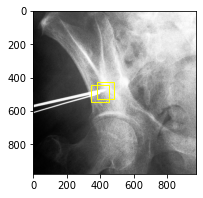

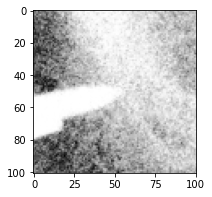

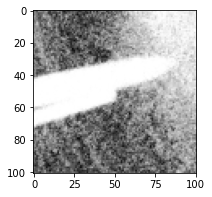

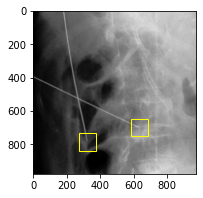

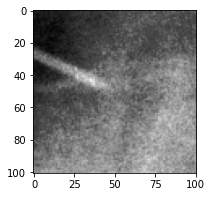

...

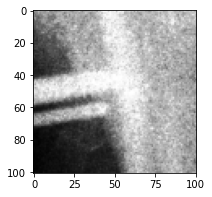

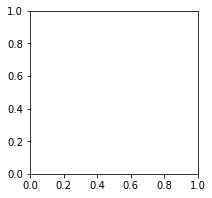

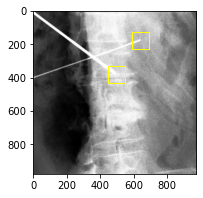

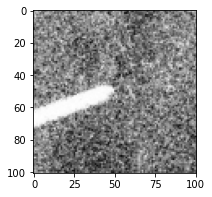

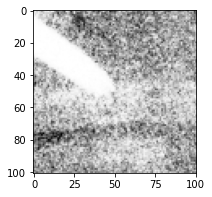

In [21]:
Eucledian_Distance_Errors=[]
Angular_Deviation_Errors=[]
unique_boxes=[]
with torch.no_grad():
    model.eval()
    for images, targets in loader_test:
        N,ED,AE=predict_plot_and_return_erros(images,targets)
        Eucledian_Distance_Errors=Eucledian_Distance_Errors+ED
        Angular_Deviation_Errors=Angular_Deviation_Errors+AE
        unique_boxes.append(N)

### Milestone 3 - Evaluate

In [22]:
print(Eucledian_Distance_Errors)
print(Angular_Deviation_Errors)
print(unique_boxes)

[3.2690305709838867, 5.964400768280029, 3.347052812576294, 2.739102602005005, 1.8240503072738647, 2.468620538711548, 10.205601692199707, 11.647294998168945, 2.1991047859191895, 2.0711381435394287, 4.153936386108398, 1.59911048412323, 4.376994609832764, 4.295658111572266, 3.9125170707702637, 4.127971649169922, 5.435202598571777, 5.0019965171813965, 4.267117500305176, 8.5159912109375, 3.6576457023620605, 2.193840980529785, 5.717901706695557, 1.4303147792816162, 3.1539955139160156, 3.0833160877227783, 4.798591136932373, 0.8186490535736084, 6.145866394042969, 2.1647093296051025, 4.160333156585693, 3.2856383323669434, 2.5951201915740967, 2.233487844467163, 6.976480007171631, 3.21223521232605, 4.12465238571167, 3.5150527954101562, 1.49093496799469, 0.5110566020011902, 3.383007049560547, 4.478923797607422, 4.574471473693848, 7.001196384429932, 4.194955348968506, 3.74233078956604, 2.7636730670928955, 1.8861453533172607, 0.6278756856918335, 2.9203062057495117, 4.471219062805176, 4.9423618316650

In [23]:
# Evaluating the Faster RCNN part 
Number_of_GT_Boxes=len(unique_boxes)*2
Number_of_Boxes_Correctly_Found=sum(unique_boxes)
Number_of_Boxes_Wrongly_Predicted=0 #Manually looked through all plots 
Number_of_Boxes_Missed=Number_of_GT_Boxes-Number_of_Boxes_Correctly_Found

# Percentage Calculations
Percentage_of_Boxes_Correctly_Identified=Number_of_Boxes_Correctly_Found/Number_of_GT_Boxes
print("Boxes Correctly Identified ",Number_of_Boxes_Correctly_Found)
print("Boxes Correctly Identified in % ",Percentage_of_Boxes_Correctly_Identified*100)

Percentage_of_Boxes_Wrongly_Identified=0
print("\n\nBoxes Wrongly Identified in ",0)
print("Boxes Wrongly Identified in % ",Percentage_of_Boxes_Wrongly_Identified*100)

Percentage_of_Boxes_Missed=Number_of_Boxes_Missed/Number_of_GT_Boxes
print("\n\nBoxes Missed ",Number_of_Boxes_Missed)
print("Boxes Missed in % ",Percentage_of_Boxes_Missed*100)

Boxes Correctly Identified  450
Boxes Correctly Identified in %  97.82608695652173


Boxes Wrongly Identified in  0
Boxes Wrongly Identified in %  0


Boxes Missed  10
Boxes Missed in %  2.1739130434782608


In [24]:
# Evaluating the Eucledian distance Error
Mean_ED_error=sum(Eucledian_Distance_Errors)/len(Eucledian_Distance_Errors)
print("Mean ED error is ",Mean_ED_error)

Median_ED_error=statistics.median(Eucledian_Distance_Errors)
print("Median ED error is ",Median_ED_error)

Mean ED error is  3.998641698408629
Median ED error is  3.3283427953720093


In [25]:
# Evaluating the Angle Error - making sure that 358 and 1 are 2 degrees apart and not 357 degrees apart
Angular_Deviation_Errors=[360-er if er>180 else er for er in Angular_Deviation_Errors]

Mean_AE_error=sum(Angular_Deviation_Errors)/len(Angular_Deviation_Errors)
print("Mean AD error is ",Mean_AE_error)

Median_AE_error=statistics.median(Angular_Deviation_Errors)
print("Median AD error is ",Median_AE_error)

Mean AD error is  9.951884889186049
Median AD error is  7.159006032219935
